---


# XG BOOST- extreme gradient boost


it is designed for better speed and performance.
works best on huge datasets

***
- Regularization
- unique regression tree
- greedy algorithm
- Parallel learning
- Weighted quantile sketch
- sparsity- aware split finding
- cache- aware access
- blocks for out-of-core-computation

***

---

load packages and libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import xgboost as xgb

In [2]:
df = pd.read_csv("Movie_classification.csv")

# DATA ANALYSIS

In [3]:
df.head()

,Marketing expense,Production expense,Multiplex coverage,Budget,Movie_length,Lead_ Actor_Rating,Lead_Actress_rating,Director_rating,Producer_rating,Critic_rating,Trailer_views,3D_available,Time_taken,Twitter_hastags,Genre,Avg_age_actors,Num_multiplex,Collection,Start_Tech_Oscar
0,20.1264,59.62,0.462,36524.125,138.7,7.825,8.095,7.910,7.995,7.94,527367,YES,109.60,223.840,Thriller,23,494,48000,1
1,20.5462,69.14,0.531,35668.655,152.4,7.505,7.650,7.440,7.470,7.44,494055,NO,146.64,243.456,Drama,42,462,43200,0
2,20.5458,69.14,0.531,39912.675,134.6,7.485,7.570,7.495,7.515,7.44,547051,NO,147.88,2022.400,Comedy,38,458,69400,1
3,20.6474,59.36,0.542,38873.890,119.3,6.895,7.035,6.920,7.020,8.26,516279,YES,185.36,225.344,Drama,45,472,66800,1
4,21.3810,59.36,0.542,39701.585,127.7,6.920,7.070,6.815,7.070,8.26,531448,NO,176.48,225.792,Drama,55,395,72400,1


In [5]:
df.columns

Index(['Marketing expense', 'Production expense', 'Multiplex coverage',
       'Budget', 'Movie_length', 'Lead_ Actor_Rating', 'Lead_Actress_rating',
       'Director_rating', 'Producer_rating', 'Critic_rating', 'Trailer_views',
       '3D_available', 'Time_taken', 'Twitter_hastags', 'Genre',
       'Avg_age_actors', 'Num_multiplex', 'Collection', 'Start_Tech_Oscar'],
      dtype='object')

In [6]:
df.shape

(506, 19)

In [7]:
df.isnull().sum()

Marketing expense       0
Production expense      0
Multiplex coverage      0
Budget                  0
Movie_length            0
Lead_ Actor_Rating      0
Lead_Actress_rating     0
Director_rating         0
Producer_rating         0
Critic_rating           0
Trailer_views           0
3D_available            0
Time_taken             12
Twitter_hastags         0
Genre                   0
Avg_age_actors          0
Num_multiplex           0
Collection              0
Start_Tech_Oscar        0
dtype: int64

In [8]:
df.dtypes

Marketing expense      float64
Production expense     float64
Multiplex coverage     float64
Budget                 float64
Movie_length           float64
Lead_ Actor_Rating     float64
Lead_Actress_rating    float64
Director_rating        float64
Producer_rating        float64
Critic_rating          float64
Trailer_views            int64
3D_available            object
Time_taken             float64
Twitter_hastags        float64
Genre                   object
Avg_age_actors           int64
Num_multiplex            int64
Collection               int64
Start_Tech_Oscar         int64
dtype: object

In [9]:
df.columns[df.dtypes == 'object']

Index(['3D_available', 'Genre'], dtype='object')

In [11]:
df['Time_taken']=df['Time_taken'].fillna(0)
avg= df['Time_taken'].mean()
avg

153.65889328063247

In [12]:
df['Time_taken']=df['Time_taken'].replace(0,avg)

In [14]:
# 0 is replaced with the avg of the time_taken column
df['Time_taken'].min()

105.36

In [23]:
df['3D_available']=df['3D_available'].map({'YES':1,'NO':0})

In [17]:
import pandas_profiling as pp

In [18]:
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/32 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
df['Genre'].unique()

array(['Thriller', 'Drama', 'Comedy', 'Action'], dtype=object)

In [22]:
df['Genre']=df['Genre'].map({'Thriller':1,'Drama':2,'Comedy':3,'Action':4})

In [24]:
df.head()

,Marketing expense,Production expense,Multiplex coverage,Budget,Movie_length,Lead_ Actor_Rating,Lead_Actress_rating,Director_rating,Producer_rating,Critic_rating,Trailer_views,3D_available,Time_taken,Twitter_hastags,Genre,Avg_age_actors,Num_multiplex,Collection,Start_Tech_Oscar
0,20.1264,59.62,0.462,36524.125,138.7,7.825,8.095,7.910,7.995,7.94,527367,1,109.60,223.840,1,23,494,48000,1
1,20.5462,69.14,0.531,35668.655,152.4,7.505,7.650,7.440,7.470,7.44,494055,0,146.64,243.456,2,42,462,43200,0
2,20.5458,69.14,0.531,39912.675,134.6,7.485,7.570,7.495,7.515,7.44,547051,0,147.88,2022.400,3,38,458,69400,1
3,20.6474,59.36,0.542,38873.890,119.3,6.895,7.035,6.920,7.020,8.26,516279,1,185.36,225.344,2,45,472,66800,1
4,21.3810,59.36,0.542,39701.585,127.7,6.920,7.070,6.815,7.070,8.26,531448,0,176.48,225.792,2,55,395,72400,1


In [25]:
df.rename(columns={'Start_Tech_Oscar':'Oscar'},inplace=True)

In [26]:
# checking after renaming the column
df.columns

Index(['Marketing expense', 'Production expense', 'Multiplex coverage',
       'Budget', 'Movie_length', 'Lead_ Actor_Rating', 'Lead_Actress_rating',
       'Director_rating', 'Producer_rating', 'Critic_rating', 'Trailer_views',
       '3D_available', 'Time_taken', 'Twitter_hastags', 'Genre',
       'Avg_age_actors', 'Num_multiplex', 'Collection', 'Oscar'],
      dtype='object')

In [33]:
features=df.corr()['Oscar'][:-1]

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17]),
 [Text(0, 0, 'Marketing expense'),
  Text(1, 0, 'Production expense'),
  Text(2, 0, 'Multiplex coverage'),
  Text(3, 0, 'Budget'),
  Text(4, 0, 'Movie_length'),
  Text(5, 0, 'Lead_ Actor_Rating'),
  Text(6, 0, 'Lead_Actress_rating'),
  Text(7, 0, 'Director_rating'),
  Text(8, 0, 'Producer_rating'),
  Text(9, 0, 'Critic_rating'),
  Text(10, 0, 'Trailer_views'),
  Text(11, 0, '3D_available'),
  Text(12, 0, 'Time_taken'),
  Text(13, 0, 'Twitter_hastags'),
  Text(14, 0, 'Genre'),
  Text(15, 0, 'Avg_age_actors'),
  Text(16, 0, 'Num_multiplex'),
  Text(17, 0, 'Collection')])

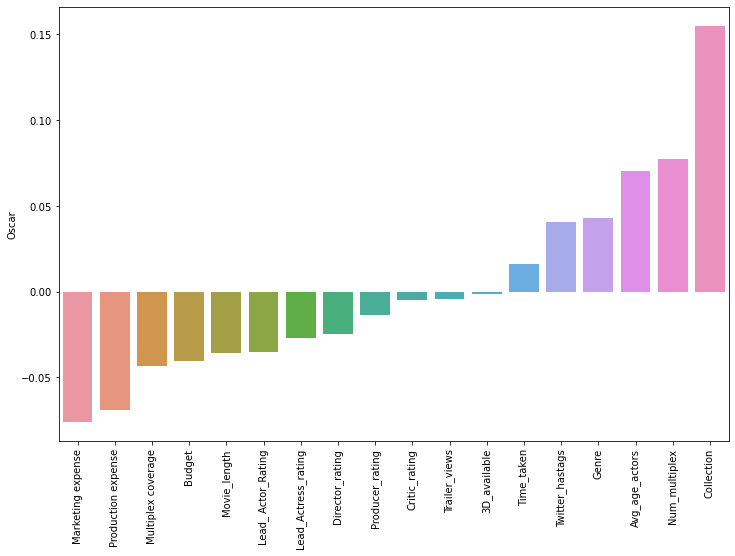

In [34]:
plt.figure(figsize=(12,8))
sns.barplot(x=features.index, y=features.sort_values())
plt.xticks(rotation=90)

In [35]:
X=df.drop('Oscar',axis=1)

In [36]:
y=df['Oscar']

In [37]:
# Split dataset
from sklearn.model_selection import train_test_split

In [38]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 42)

In [41]:
from sklearn.preprocessing import StandardScaler

In [43]:
scaler= StandardScaler()
scaled_X_train,scaled_X_test = scaler.fit_transform(X_train),scaler.transform(X_test)

In [44]:
#load Gradient Boosting From Sklearn
from sklearn.ensemble import GradientBoostingClassifier

In [45]:
GB_classifier=GradientBoostingClassifier()
GB_classifier.fit(scaled_X_train,y_train)

GradientBoostingClassifier()

In [47]:
y_predictions = GB_classifier.predict(scaled_X_test)
y_predictions

array([0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
       0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1,
       1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1])

In [48]:
from sklearn.metrics import classification_report, plot_confusion_matrix,confusion_matrix,accuracy_score

In [49]:
accuracy_score(y_test,y_predictions)

0.6062992125984252

In [50]:
from sklearn.tree import DecisionTreeClassifier

In [51]:
dTree_clf = DecisionTreeClassifier()

In [52]:
dTree_clf.fit(scaled_X_train,y_train)
y_pred2 = dTree_clf.predict(scaled_X_test)

In [53]:
print("Accuracy of Model::",accuracy_score(y_test,y_pred2))

Accuracy of Model:: 0.5669291338582677


Gradient boosting gave a better accuracy

# XG Boost

In [54]:
xgb_classifier = xgb.XGBClassifier()

In [55]:
xgb_classifier.fit(scaled_X_train,y_train)

[22:40:27] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Users/isita/Downloads/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [56]:
predictions = xgb_classifier.predict(scaled_X_test)

In [57]:
print("Accuracy of Model::",accuracy_score(y_test,predictions))

Accuracy of Model:: 0.6377952755905512


clearly XG boost gave us better accuracy

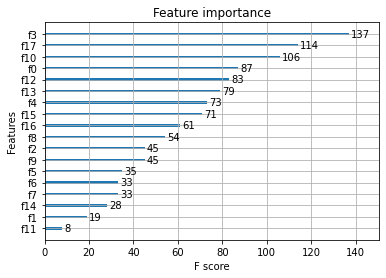

In [58]:
# Feature Importance
xgb.plot_importance(xgb_classifier)
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

# hyper parameter optimization xg boost

In [59]:
from sklearn.model_selection import RandomizedSearchCV

In [60]:
params={
 "learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
 "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
 "min_child_weight" : [ 1, 3, 5, 7 ],
 "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
 "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
    
}

In [61]:
random_search=RandomizedSearchCV(xgb_classifier,param_distributions=params,n_iter=5,scoring='roc_auc',n_jobs=-1,cv=5,verbose=3)

In [63]:
random_search.fit(scaled_X_train,y_train)
random_search.best_estimator_

Fitting 5 folds for each of 5 candidates, totalling 25 fits


/Users/isita/Downloads/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[22:50:38] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7, gamma=0.0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.3, max_delta_step=0, max_depth=8,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [64]:
random_search.best_params_

{'min_child_weight': 1,
 'max_depth': 8,
 'learning_rate': 0.3,
 'gamma': 0.0,
 'colsample_bytree': 0.7}

In [70]:
classifier=xgb.XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7, gamma=0.0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.3, max_delta_step=0, max_depth=8,
              min_child_weight=1, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


In [73]:
classifier.fit(scaled_X_train,y_train)
pred_3=classifier.predict(scaled_X_test)

/Users/isita/Downloads/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[22:55:06] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [74]:
accuracy_score(y_test,pred_3)

0.7086614173228346

---

we get the best accuracy after hyperparameter tuning!!.

---